# COVID-19 Forcasting
> BIOSTAT823 Final Project: Shannon Murphy, Jennie Sun, Malcolm Smith Fraser

- toc: false
- branch: master
- badges: true
- comments: true
- categories: [fastpages, jupyter]
- image: images/some_folder/your_image.png
- hide: false
- search_exclude: true
- metadata_key1: metadata_value1
- metadata_key2: metadata_value2
- use_plotly: true

### Project description
https://github.com/jenniesun/covid_forcasting/blob/main/README.md

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
%cd "/content/drive/MyDrive/bios823-final"

/content/drive/.shortcut-targets-by-id/12TEcv7JzOSY0tIiVilll4KTmjUIgHhd2/bios823-final


In [3]:
!ls "/content/drive/MyDrive/bios823-final"

 AWS_casesDHPC.csv
 AWS_casesdurham.csv
 AWS_casesNC.csv
 AWS_casesUSA.csv
'DHHS Cases & Deaths By County.csv'
 DHHS_HOSPITAL_BEDS_VENTILATORS_REGION.xls
 DHHS_HOSPITAL_BEDS_VENTILATORS_STATE.csv
 DHHS_HOSPITAL_METRICS_REGION.csv
 DHHS_HOSPITAL_METRICS_REGION.xls
 DHHS_HOSPITAL_METRICS_STATE.csv
'DHHS: Positive by County-All.csv'
 logs.log


In [4]:
!pwd

/content/drive/.shortcut-targets-by-id/12TEcv7JzOSY0tIiVilll4KTmjUIgHhd2/bios823-final


### Data Processing

In [5]:
import pandas as pd

In [6]:
cases_deaths = pd.read_csv('AWS_casesDHPC.csv')
cases_deaths.head()

,Date,Confirmed (daily growth) (CUSTOM),Deaths (daily growth) (CUSTOM),Confirmed (window average) (CUSTOM),Deaths (window average) (CUSTOM)
0,2021-11-02 00:00:00,39.0,0.0,188.4000,1.6000
1,2021-11-01 00:00:00,704.0,2.0,223.3333,2.5000
2,2021-10-31 00:00:00,0.0,0.0,252.8571,2.2857
3,2021-10-30 00:00:00,34.0,0.0,231.0000,2.0000
4,2021-10-29 00:00:00,165.0,6.0,305.0000,2.5000


In [7]:
cases_deaths = cases_deaths.drop(columns= [ "Confirmed (window average) (CUSTOM)", "Deaths (window average) (CUSTOM)"])

In [8]:
cases_deaths['Date'] = pd.to_datetime(cases_deaths['Date']).dt.date
cases_deaths['Date'] = cases_deaths['Date'].astype('str')

In [9]:
cases_deaths.head()

,Date,Confirmed (daily growth) (CUSTOM),Deaths (daily growth) (CUSTOM)
0,2021-11-02,39.0,0.0
1,2021-11-01,704.0,2.0
2,2021-10-31,0.0,0.0
3,2021-10-30,34.0,0.0
4,2021-10-29,165.0,6.0


In [10]:
beds_vents = pd.read_excel('DHHS_HOSPITAL_BEDS_VENTILATORS_REGION.xls')

In [11]:
beds_ventsDHPC = beds_vents[beds_vents["Coalition"] == "DHPC"]

In [12]:
hosp = pd.read_excel('DHHS_HOSPITAL_METRICS_REGION.xls')

In [13]:
hospDHPC = hosp[hosp["Coalition"] == "DHPC"]

In [14]:
hospall = pd.merge(hospDHPC, beds_ventsDHPC.drop(columns = ["Coalition"]), how = 'outer', on = 'Date')
hospall.sample(10)

,Index_x,Date,Coalition,Hospitalizations,Adult ICU COVID-19 Patients,Confirmed Patient Admitted - Last 24 Hours,Hospitalized and Ventilated COVID Inpatient Count,Index_y,Ventilators In Use,Ventilators Available,ICU Beds In Use,ICU Empty Staffed Beds,Inpatient Beds In Use,Inpatient Empty Staffed Beds
121,970,2021-07-04,DHPC,37,9.0,4.0,9.0,970,74,168,133,30,1293,417
57,458,2021-09-06,DHPC,234,55.0,23.0,45.0,458,118,124,164,12,1418,247
337,2698,2020-11-30,DHPC,148,36.0,16.0,21.0,2698,77,165,176,14,1418,368
87,698,2021-08-07,DHPC,112,29.0,15.0,20.0,698,93,149,141,20,1361,244
553,4426,2020-04-28,DHPC,67,NaN,NaN,NaN,4426,108,327,160,60,1548,682
10,82,2021-10-23,DHPC,105,39.0,6.0,21.0,82,94,148,158,15,1357,291
225,1802,2021-03-22,DHPC,141,37.0,14.0,28.0,1802,102,140,168,19,1467,305
51,410,2021-09-12,DHPC,225,60.0,29.0,49.0,410,129,113,163,17,1431,203
72,578,2021-08-22,DHPC,187,48.0,26.0,31.0,578,119,123,166,16,1387,220
149,1194,2021-06-06,DHPC,61,17.0,4.0,12.0,1194,92,150,147,20,1265,419


In [15]:
hospall['Date'] = hospall['Date'].astype('str')

In [16]:
df = pd.merge(hospall, cases_deaths, how = 'outer', on = 'Date')
df.sample(10)

,Index_x,Date,Coalition,Hospitalizations,Adult ICU COVID-19 Patients,Confirmed Patient Admitted - Last 24 Hours,Hospitalized and Ventilated COVID Inpatient Count,Index_y,Ventilators In Use,Ventilators Available,ICU Beds In Use,ICU Empty Staffed Beds,Inpatient Beds In Use,Inpatient Empty Staffed Beds,Confirmed (daily growth) (CUSTOM),Deaths (daily growth) (CUSTOM)
169,1354.0,2021-05-17,DHPC,71.0,17.0,9.0,14.0,1354.0,98.0,144.0,168.0,20.0,1399.0,386.0,152.0,2.0
318,2546.0,2020-12-19,DHPC,158.0,34.0,30.0,23.0,2546.0,80.0,160.0,164.0,27.0,1298.0,466.0,176.0,3.0
400,3202.0,2020-09-28,DHPC,79.0,23.0,28.0,16.0,3202.0,86.0,152.0,123.0,12.0,1442.0,287.0,275.0,1.0
484,3874.0,2020-07-06,DHPC,107.0,32.0,11.0,NaN,3874.0,94.0,145.0,156.0,24.0,1379.0,405.0,459.0,5.0
111,890.0,2021-07-14,DHPC,46.0,17.0,5.0,12.0,890.0,79.0,163.0,146.0,17.0,1487.0,233.0,107.0,2.0
598,NaN,2020-03-14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0
558,4466.0,2020-04-23,DHPC,65.0,NaN,NaN,NaN,4466.0,108.0,264.0,145.0,56.0,1269.0,658.0,63.0,3.0
530,4242.0,2020-05-21,DHPC,78.0,NaN,NaN,NaN,4242.0,107.0,293.0,180.0,8.0,1589.0,293.0,100.0,4.0
143,1146.0,2021-06-12,DHPC,54.0,15.0,7.0,13.0,1146.0,93.0,149.0,151.0,27.0,1359.0,336.0,37.0,0.0
314,2514.0,2020-12-23,DHPC,181.0,42.0,22.0,27.0,2514.0,90.0,148.0,171.0,22.0,1304.0,459.0,1347.0,1.0


### EDA

In [17]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip --quiet

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [18]:
import pandas_profiling as pp

In [19]:
#hide
pp.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
df_new = df[:518].copy()

In [21]:
df_new.isna().any()

Index_x                                              False
Date                                                 False
Coalition                                            False
Hospitalizations                                     False
Adult ICU COVID-19 Patients                          False
Confirmed Patient Admitted - Last 24 Hours           False
Hospitalized and Ventilated COVID Inpatient Count     True
Index_y                                              False
Ventilators In Use                                   False
Ventilators Available                                False
ICU Beds In Use                                      False
ICU Empty Staffed Beds                               False
Inpatient Beds In Use                                False
Inpatient Empty Staffed Beds                         False
Confirmed (daily growth) (CUSTOM)                    False
Deaths (daily growth) (CUSTOM)                       False
dtype: bool

In [22]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 518 entries, 0 to 517
Data columns (total 16 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   Index_x                                            518 non-null    float64
 1   Date                                               518 non-null    object 
 2   Coalition                                          518 non-null    object 
 3   Hospitalizations                                   518 non-null    float64
 4   Adult ICU COVID-19 Patients                        518 non-null    float64
 5   Confirmed Patient Admitted - Last 24 Hours         518 non-null    float64
 6   Hospitalized and Ventilated COVID Inpatient Count  434 non-null    float64
 7   Index_y                                            518 non-null    float64
 8   Ventilators In Use                                 518 non-null    float64
 9   Ventilator

In [23]:
df_new.loc[:,'Date'] = pd.to_datetime(df_new['Date'], infer_datetime_format=True)

In [24]:
df_new['Year-Week'] = df_new['Date'].dt.strftime('%Y-%U')
df_new = df_new.sort_values('Date',ascending=False).fillna(0).drop(['Index_x','Index_y'],axis=1)

In [25]:
df_week = df_new.groupby('Year-Week').mean()

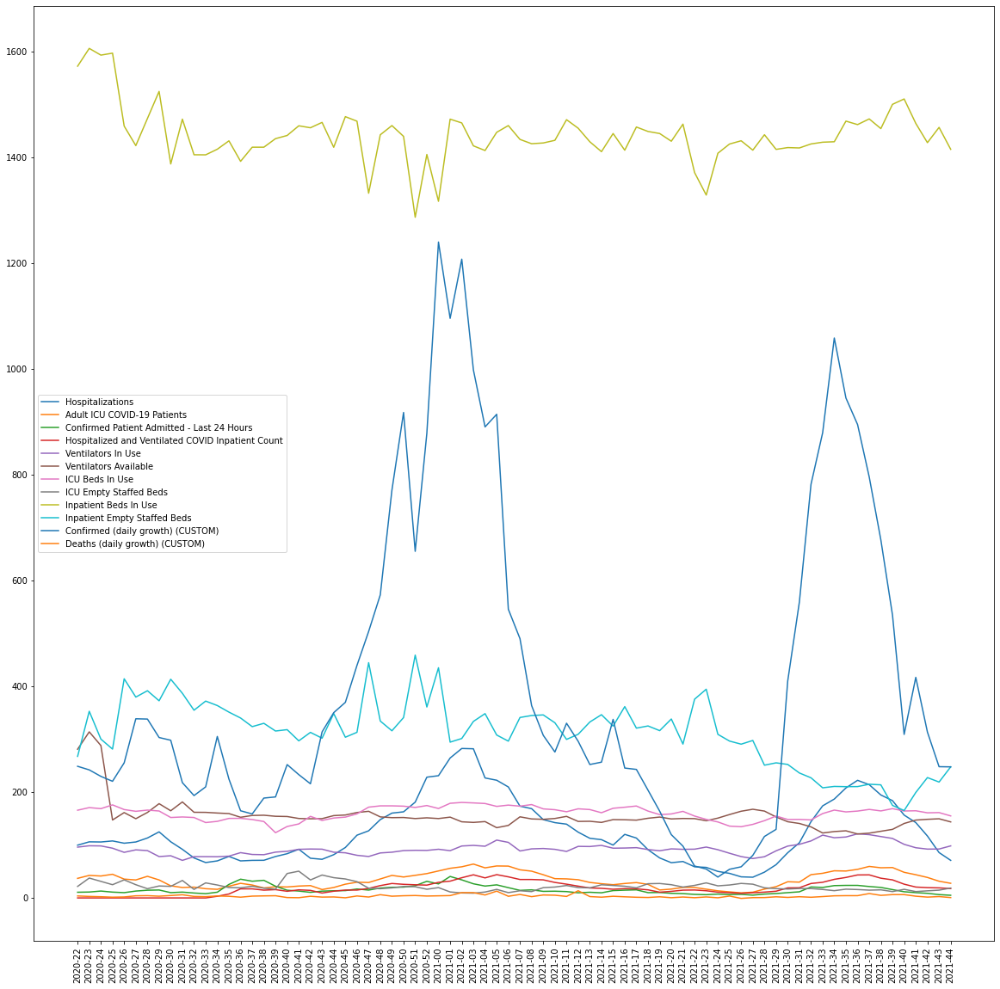

In [26]:
import matplotlib.pyplot as plt
%matplotlib inline

plt.figure(figsize=(20,20))
p = plt.plot(df_week)
plt.legend(df_week.columns)
t = plt.xticks(rotation=90)

#### Correlation Heatmap

In [27]:
import seaborn as sns
import matplotlib.pyplot as plt

%matplotlib inline

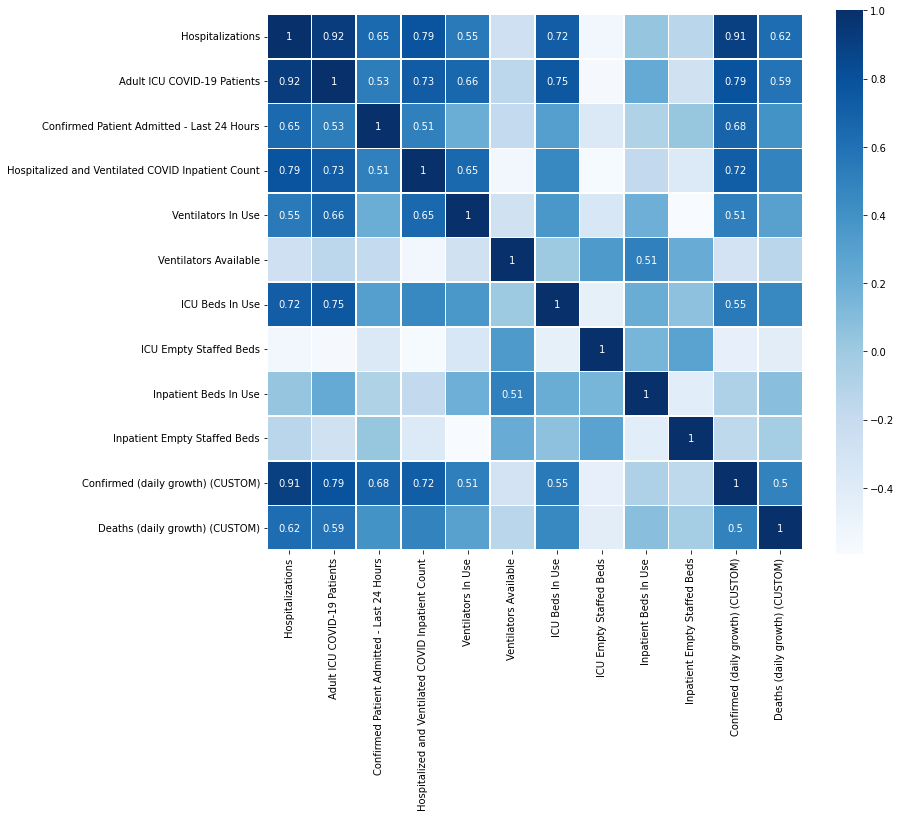

In [28]:
f, ax = plt.subplots(figsize=(12, 10))

# calculate the correlation matrix
corr = df_week.corr()

# plot the heatmap
sns.heatmap(corr, cmap="Blues", annot=True,
            square=True,
                linewidth=.5, ax=ax,
        xticklabels=corr.columns,
        yticklabels=corr.columns)

for t in ax.texts:
    if float(t.get_text())>=0.5:
        t.set_text(t.get_text()) #if the value is greater than 0.4 then I set the text 
    else:
        t.set_text("") # if not it sets an empty text

### Model building and forecasting

Univariate:
1. Deaths (daily growths)

Multivariate:
* Ability to forecast future deaths will be compared to the univariate model

### Univariate Analysis on the Growth of COVID-19 Death Count 

Reference: 
*  https://www.kaggle.com/prashant111/complete-guide-on-time-series-analysis-in-python
* https://medium.com/swlh/temperature-forecasting-with-arima-model-in-python-427b2d3bcb53

In this section, we start our analysis on the growth of covid death count with a univariate time series analysis. Since it's a univariate time-series forecasting, we are only using two variables in which one is time and the other is the field to forecaste. In this case, it is the `Deaths (daily growth) (CUSTOM)'` variable in the dataset. 

We start our analysis by doing EDA to detect if there's any trend and seasonality pattern of changes with regards to time. These are shown in the the autocorrelation, seasonality, and lag plots below.

We then use an ARIMA (Auto-Regressive Integrated Moving Average) model to conduct the forecasting task. ARIMA is a class of models that based on its own lags and the lagged forecast errors. Any non-seasonal time series that exhibits patterns and is not a random white noise can be modelled with ARIMA models.

Using the best order returned by the `auto_arima` package for model training, we were able to achieve a RMSE of 2.18 as a result. 

In [29]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
def plot_ts(ts, lags=None):
    fig = plt.figure(figsize = (12, 10))
    ax1 = plt.subplot2grid((2, 2), (0, 0), colspan=2)
    ax2 = plt.subplot2grid((2, 2), (1, 0))
    ax3 = plt.subplot2grid((2, 2), (1, 1))
    
    ax1.plot(ts)
    ax1.plot(ts.rolling(window=lags).mean())
    plot_acf(ts, ax=ax2, lags=lags)
    plot_pacf(ts, ax=ax3, lags=lags)
    
    plt.tight_layout()
    return fig

#### Autocorrelation and Partial Autocorrelation Functions 

Autocorrelation is simply the correlation of a series with its own lags. If a series is significantly autocorrelated, that means, the previous values of the series (lags) may be helpful in predicting the current value.
Partial Autocorrelation also conveys similar information but it conveys the pure correlation of a series and its lag, excluding the correlation contributions from the intermediate lags.

/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


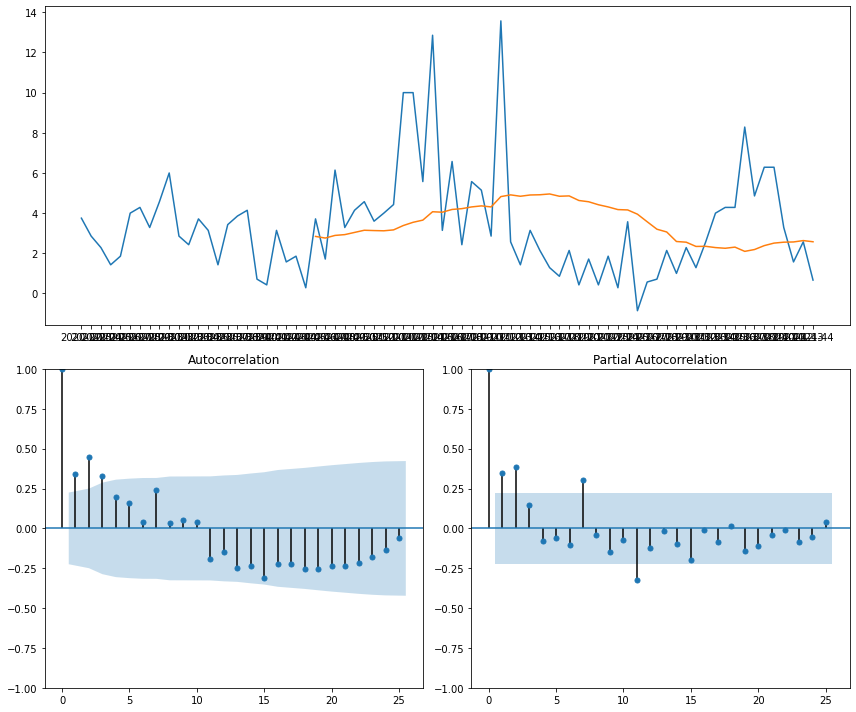

In [30]:
plot_ts(df_week['Deaths (daily growth) (CUSTOM)'], lags=25)
pass

#### Test for seasonality of a time series? 
The common way to test for seasonality of a time series is to plot the series and check for repeatable patterns in fixed time intervals. So, the types of seasonality is determined by the clock or the calendar.
* Hour of day
* Day of month
* Weekly
* Monthly
* Yearly

However, if we want a more definitive inspection of the seasonality, use the Autocorrelation Function (ACF) plot. There is a strong seasonal pattern, the ACF plot usually reveals definitive repeated spikes at the multiples of the seasonal window.

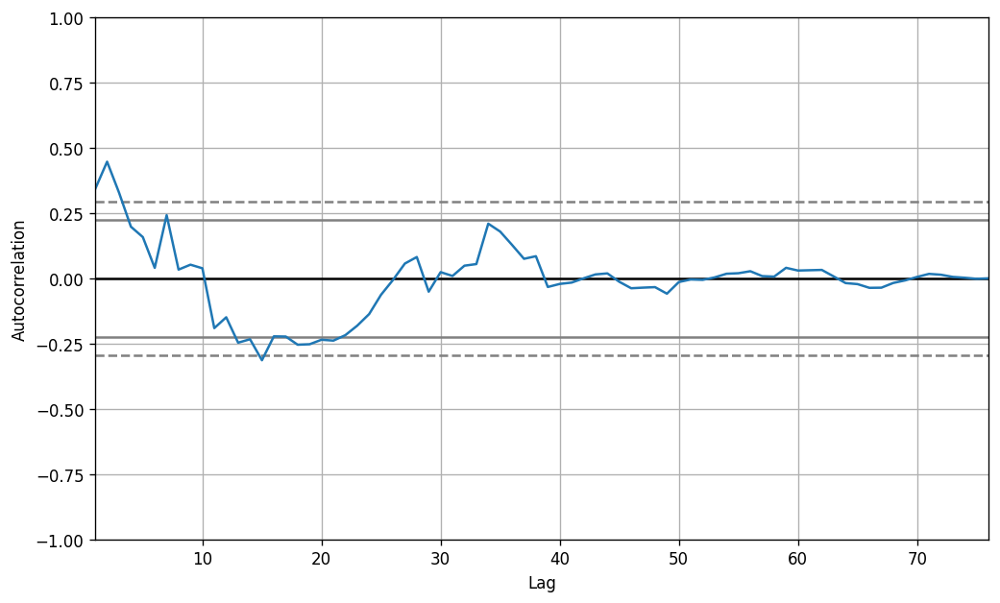

In [31]:
# Test for seasonality
from pandas.plotting import autocorrelation_plot

# Draw Plot
plt.rcParams.update({'figure.figsize':(10,6), 'figure.dpi':120})
autocorrelation_plot(df_week['Deaths (daily growth) (CUSTOM)'].tolist())

#### Lag Plots 

A Lag plot is a scatter plot of a time series against a lag of itself. It is normally used to check for autocorrelation. If there is any pattern existing in the series, the series is autocorrelated. If there is no such pattern, the series is likely to be random white noise.

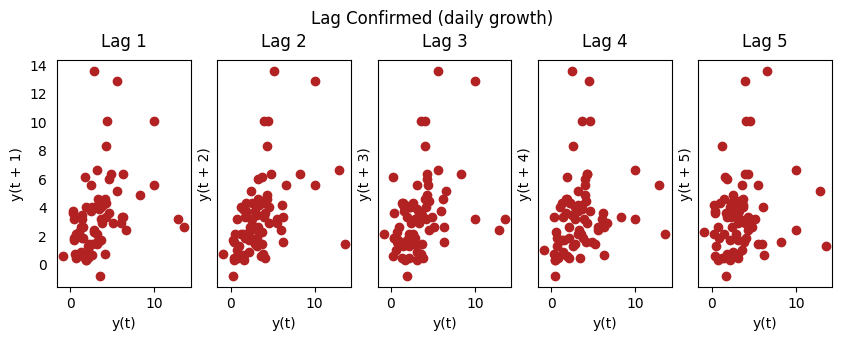

In [32]:
from pandas.plotting import lag_plot
plt.rcParams.update({'ytick.left' : False, 'axes.titlepad':10})

n = 5
# Plot
fig, axes = plt.subplots(1, n, figsize=(10,3), sharex=True, sharey=True, dpi=100)
for i, ax in enumerate(axes.flatten()[:n]):
    lag_plot(df_week['Deaths (daily growth) (CUSTOM)'], lag=i+1, ax=ax, c='firebrick')
    ax.set_title('Lag ' + str(i+1))

fig.suptitle('Lag Confirmed (daily growth)', y=1.05)    
plt.show()

#### ARIMA Model - figuring out the best order

In [54]:
#!setup.py install

In [53]:
#!pip install pmdarima 

In [52]:
#!pip install scipy==1.2.0

In [36]:
from pmdarima import auto_arima
stepwise_fit = auto_arima(df_week['Deaths (daily growth) (CUSTOM)'], trace=True,
                          suppress_warnings=True)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=349.393, Time=0.13 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=366.852, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=359.373, Time=0.07 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=363.443, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=439.475, Time=0.01 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=348.800, Time=0.09 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=356.376, Time=0.07 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=352.816, Time=0.08 sec
 ARIMA(1,0,3)(0,0,0)[0] intercept   : AIC=349.156, Time=0.10 sec
 ARIMA(0,0,3)(0,0,0)[0] intercept   : AIC=349.002, Time=0.09 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=351.051, Time=0.07 sec
 ARIMA(2,0,3)(0,0,0)[0] intercept   : AIC=351.041, Time=0.24 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=355.537, Time=0.05 sec

Best model:  ARIMA(1,0,2)(0,0,0)[0] intercept
Total fit time: 1.105 seconds


#### Train the Model

In [37]:
import warnings

warnings.filterwarnings("ignore")

In [38]:
from statsmodels.tsa.arima.model import ARIMA

In [39]:
#### Split The Dataset
df_train, df_test= df_week[0:-5], df_week[-5:]
print(df_train.shape, df_test.shape)

(71, 12) (5, 12)


In [40]:
model_deaths=ARIMA(df_train['Deaths (daily growth) (CUSTOM)'],order=(1,0,2))
model_deaths=model_deaths.fit()
model_deaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:     Deaths (daily growth) (CUSTOM)   No. Observations:                   71
Model:                             ARIMA(1, 0, 2)   Log Likelihood                -159.231
Date:                            Sat, 20 Nov 2021   AIC                            328.463
Time:                                    19:30:31   BIC                            339.776
Sample:                                         0   HQIC                           332.961
                                             - 71                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.5249      0.952      3.702      0.000       1.659       5.391
ar.L1          0.6590      0.179      3.688      0.000       0.309       1.009
ma.L1         -0.5335      0.209     -2.548      0.011      -0.944      -0.123
ma.L2          0.3799      0.105      3.620      0.000       0.174       0.586
sigma2         5.1482      0.613      8.402      0.000       3.947       6.349
===================================================================================
Ljung-Box (L1) (Q):                   0.03   Jarque-Bera (JB):                47.86
Prob(Q):                              0.87   Prob(JB):                         0.00
Heteroskedasticity (H):               0.91   Skew:                             1.13
Prob(H) (two-sided):                  0.82   Kurtosis:                         6.33
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

### Check How Good The Model Is

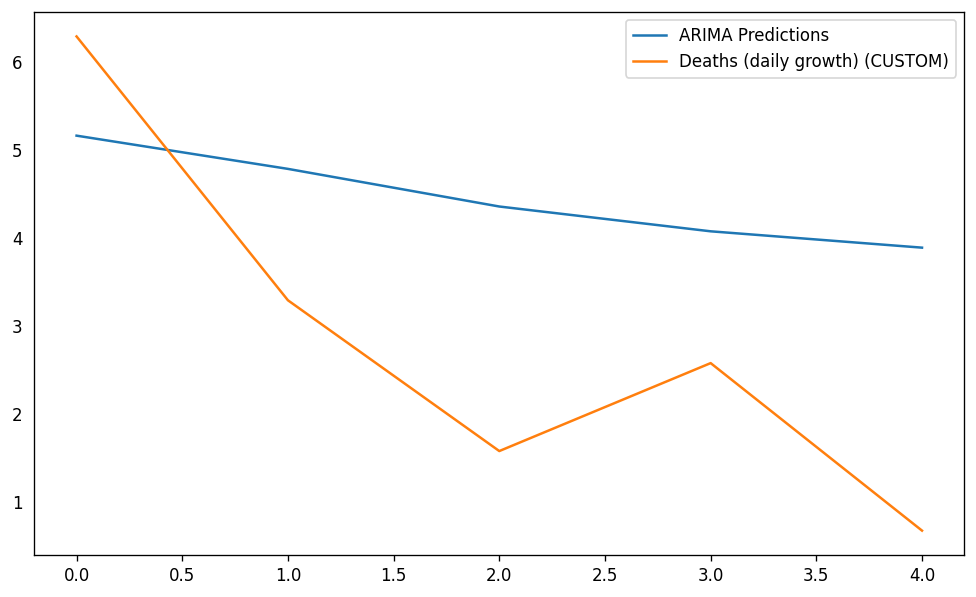

In [41]:
start=len(df_train)
end=len(df_train)+len(df_test)-1
pred=model_deaths.predict(start=start,end=end).rename('ARIMA Predictions')
pred.reset_index(inplace=True, drop=True)#.plot(legend=True)
test = df_test['Deaths (daily growth) (CUSTOM)']#.plot(legend=True)
test.reset_index(drop=True, inplace=True)
pred.plot(legend=True)
test.plot(legend=True)

#### Check Accuracy Metric

In [42]:
from sklearn.metrics import mean_squared_error
from math import sqrt
df_test['Deaths (daily growth) (CUSTOM)'].mean()
rmse=sqrt(mean_squared_error(pred,df_test['Deaths (daily growth) (CUSTOM)']))
print(rmse)

2.1833080260513316


### Multivariate Modeling

In this section we compare the effectiveness of the univariate model to that of a multivariate model at forecasting deaths. We explores three approaches to the multivariate model.
* Model with only the features highly correlated with deaths
* Model with only the features with low correlation to deaths
* Model with all features

Since the best performace of the univariate model used a lag of 1 week, we evaluate all our multvariate models with a lag of one week - though an exploratory analysis also showed that lag=1 was the optimal choice for forecasting deaths with the multivariate models.

As with the univariate modeling, we reserved the last 5 weeks of the data for testing and trained on the rest.

#### Results

The multivariate model with only the low correlated features was the best at forecasting future deaths - outperforming the univariate model (rmse 2.183) and all other multivariate models with an rmse of 1.576 across the 5 forecasted weeks. The multivariate models with all features and the highly correlated features both underperformed as compared to the univariate model with rmse values of 8.993 and 3.379 respectively.

Intuitively, this result is rather interesting. One would expect that the multivaraite model with features uncorrelated with deaths would yeild results similar to the multivariate model. Another interesting finding with the multivariate model with the highly correlated features is that although more of the variance in the distribution of Deaths is accounted for by other features - these relationships make the model worse at forecasting future values.

In [43]:
## Features with low correlation to Deaths
df_multivar = df_week[['Ventilators Available',
                       "ICU Empty Staffed Beds",
                       "Inpatient Beds In Use",
                       "Inpatient Empty Staffed Beds", 
                       "Confirmed (daily growth) (CUSTOM)",
                       "Deaths (daily growth) (CUSTOM)"]]

## Features with high correlation to Deaths
df_multivar_deaths = df_week[['Adult ICU COVID-19 Patients',
                              'Hospitalizations',
                              "Deaths (daily growth) (CUSTOM)"]]

In [44]:
## Check for stationarity

from statsmodels.tsa.stattools import adfuller
def adf_test(ts, signif=0.05):
    dftest = adfuller(ts, autolag='AIC')
    adf = pd.Series(dftest[0:4], index=['Test Statistic','p-value','# Lags','# Observations'])
    for key,value in dftest[4].items():
       adf['Critical Value (%s)'%key] = value
    print (adf)
    
    p = adf['p-value']
    if p <= signif:
        print(f" Series is Stationary")
    else:
        print(f" Series is Non-Stationary")

df_train_multivar_deaths, df_test_multivar_deaths= df_multivar_deaths[0:-5], df_multivar_deaths[-5:]
df_train_multivar, df_test_multivar= df_multivar[0:-5], df_multivar[-5:]
df_train_week, df_test_week= df_week[0:-5], df_week[-5:]

#apply adf test on the series
# for col in df_train_multivar_deaths.columns:
#   print(col)
#   adf_test(df_train[col])
#   print('\n')

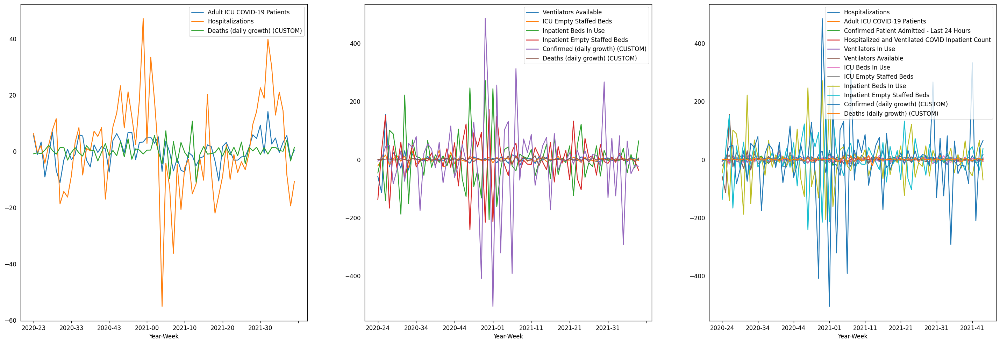

In [45]:
## Differencing to stationize data

# df_train_multivar_deaths 1st difference
df_differenced_deaths = df_train_multivar_deaths.diff().dropna()

# df_train_multivar 2nd difference
df_differenced_multivar = df_train_multivar.diff().dropna().diff().dropna()

# df_train_week 2nd differnce
df_differenced_week = df_week.diff().dropna().diff().dropna()


fig, ax = plt.subplots(1,3,figsize=(30,10))
df_differenced_deaths.plot(ax=ax[0])
df_differenced_multivar.plot(ax=ax[1])
df_differenced_week.plot(ax=ax[2])

In [46]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.tsa.api import VAR

In [47]:
model_deaths = VAR(df_differenced_deaths)
results_deaths = model_deaths.fit(maxlags=1, ic='aic')

model_multivar = VAR(df_differenced_multivar)
results_multivar = model_multivar.fit(maxlags=1, ic='aic')

model_week = VAR(df_differenced_week)
results_week = model_week.fit(maxlags=1, ic='aic')

In [48]:
results_week.fittedvalues

,Hospitalizations,Adult ICU COVID-19 Patients,Confirmed Patient Admitted - Last 24 Hours,Hospitalized and Ventilated COVID Inpatient Count,Ventilators In Use,Ventilators Available,ICU Beds In Use,ICU Empty Staffed Beds,Inpatient Beds In Use,Inpatient Empty Staffed Beds,Confirmed (daily growth) (CUSTOM),Deaths (daily growth) (CUSTOM)
Year-Week,,,,,,,,,,,,
2020-25,-6.050485,2.571796,-3.674547,-1.248554,-4.268341,-25.286072,2.715895,9.606845,5.237299,95.264854,12.715599,0.995566
2020-26,0.841886,-8.505686,0.932374,1.412348,-3.561475,71.356757,-9.140887,8.954232,-91.906945,96.989570,-34.024446,-0.681911
2020-27,9.372419,10.357518,3.587820,0.520694,11.635341,-72.492507,10.464019,-21.589798,126.202257,-189.412804,-27.932143,-0.290757
2020-28,-6.700359,0.747079,-4.281281,-0.954611,-7.374172,-0.807632,-0.684545,12.333799,-16.964079,79.312145,15.812267,-1.371074
2020-29,-3.578085,-7.204370,0.564765,-1.919890,2.862489,20.501958,-3.333372,2.376715,-44.541052,-17.571175,51.624019,0.448288
...,...,...,...,...,...,...,...,...,...,...,...,...
2021-40,-10.054939,-2.235180,-0.490999,-2.444100,-1.605599,0.329972,-2.491746,0.217647,-36.895521,19.680909,-23.882875,-3.409703
2021-41,9.406515,2.275158,1.615133,2.217752,4.055383,-7.766720,1.922657,-4.353006,-0.639843,-6.595155,77.116939,1.667153
2021-42,1.464888,1.515541,-1.325866,2.073178,1.271944,7.655197,-3.566606,4.043580,13.471868,-0.115702,-168.821501,1.548252


In [49]:
# forecasting
def forecast(results, df_test):
  pred = results.forecast(results.fittedvalues.values, steps=5) # forcast 5 steps out
  df_forecast = pd.DataFrame(pred, index=df_test.index[:], columns=df_test.columns + '_1d')
  return df_forecast

df_forecast_deaths   = forecast(results_deaths, df_test_multivar_deaths)
df_forecast_multivar = forecast(results_multivar,df_test_multivar)
df_forecast_week     = forecast(results_week, df_test_week)


# inverting the difference transformations for the forcasted values
def invert_transformation(df_train, df_forecast, second_diff=False):
    """Revert back the differencing to get the forecast to original scale."""
    df_fc = df_forecast.copy()
    columns = df_train.columns
    for col in columns:        
        # Roll back 2nd Diff
        if second_diff:
            df_fc[str(col)+'_1d'] = (df_train[col].iloc[-1]-df_train[col].iloc[-2]) + df_fc[str(col)+'_1d'].cumsum()
        # Roll back 1st Diff
        df_fc[str(col)+'_forecast'] = df_train[col].iloc[-1] + df_fc[str(col)+'_1d'].cumsum()
    return df_fc

# get inverted results in a dataframe
df_results_deaths = invert_transformation(df_train_multivar_deaths, df_forecast_deaths, second_diff=False)
df_results_multivar = invert_transformation(df_train_multivar, df_forecast_multivar, second_diff=True)
df_results_weeks = invert_transformation(df_train_week, df_forecast_week, second_diff=True)
         

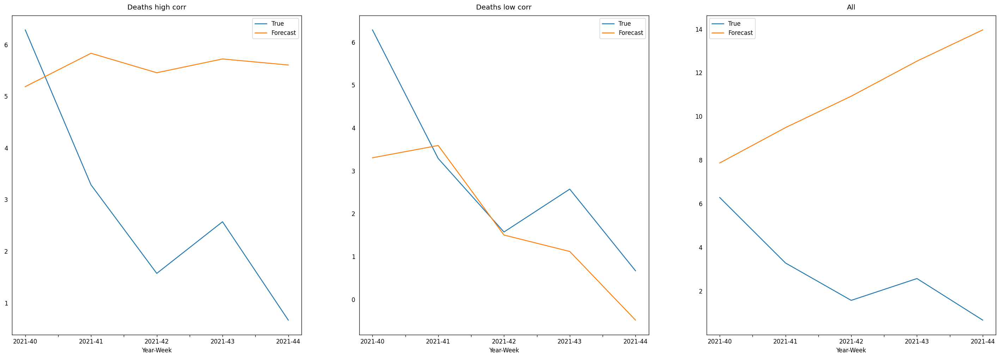

In [50]:
fig, ax = plt.subplots(1,3,figsize=(30,10))
df_test_multivar_deaths['Deaths (daily growth) (CUSTOM)'].plot(ax=ax[0],label='True',legend=True, title='Deaths high corr')
df_results_deaths.filter(like='forecast')['Deaths (daily growth) (CUSTOM)_forecast'].plot(ax=ax[0],label='Forecast',legend=True)

df_test_multivar['Deaths (daily growth) (CUSTOM)'].plot(ax=ax[1],label='True',legend=True, title='Deaths low corr')
df_results_multivar.filter(like='forecast')['Deaths (daily growth) (CUSTOM)_forecast'].plot(ax=ax[1],label='Forecast',legend=True)

df_test_week['Deaths (daily growth) (CUSTOM)'].plot(ax=ax[2],label='True',legend=True, title="All")
df_results_weeks.filter(like='forecast')['Deaths (daily growth) (CUSTOM)_forecast'].plot(ax=ax[2],label='Forecast',legend=True)

In [51]:
##### 
# RMSE between forcasted and real values for deaths (and overall) across the last 5 weeks
#####

def get_error(results, df_test):
    p_error = (results.values - df_test[:].values)/df_test[:].values
    mse = mean_squared_error(df_test, results,multioutput='raw_values', squared=False)
    return mse


error_deaths   = get_error(df_results_deaths.filter(like   = 'forecast'), df_test_multivar_deaths)
error_multivar = get_error(df_results_multivar.filter(like = 'forecast'), df_test_multivar)
error_weeks    = get_error(df_results_weeks.filter(like    = 'forecast'), df_test_week)

print(f"==>Death high corr RMSE\n Overall: {abs(error_deaths.mean()).mean():.4f}\n{list(zip(df_test_multivar_deaths,error_deaths))[-1]}\n")
print(f"==>Death low corr RMSE\n Overall: {abs(error_multivar.mean()).mean():.4f}\n{list(zip(df_test_multivar,error_multivar))[-1]}\n")
print(f"==>Death all RMSE\n Overall: {abs(error_weeks.mean()).mean():.4f}\n{list(zip(df_test_week,error_weeks))[-1]}\n")

# print(f"==>Death high corr {abs(error_deaths.mean()).mean():15.4f}\n{error_deaths.mean()}\n")
# print(f"==>Death low corr {abs(error_multivar.mean()).mean():20.4f}\n{error_multivar.mean()}\n")
# print(f"==>Death all {abs(error_weeks.mean()).mean():40.4f}\n{error_weeks.mean()}\n")

==>Death high corr RMSE
 Overall: 31.9465
('Deaths (daily growth) (CUSTOM)', 3.3799641450971647)

==>Death low corr RMSE
 Overall: 118.0806
('Deaths (daily growth) (CUSTOM)', 1.5768054964607212)

==>Death all RMSE
 Overall: 69.8256
('Deaths (daily growth) (CUSTOM)', 8.993726124217844)

